### Background & Context
The Thera bank recently saw a steep decline in the number of users of their credit card, credit cards are a good source of income for banks because of different kinds of fees charged by the banks like annual fees, balance transfer fees, and cash advance fees, late payment fees, foreign transaction fees, and others. Some fees are charged to every user irrespective of usage, while others are charged under specified circumstances.

Customers’ leaving credit cards services would lead bank to loss, so the bank wants to analyze the data of customers and identify the customers who will leave their credit card services and reason for same – so that bank could improve upon those areas


### Variables
- CLIENTNUM: Client number. Unique identifier for the customer holding the account
- Attrition_Flag: Internal event (customer activity) variable - if the account is closed then "Attrited Customer" else "Existing Customer"
- Customer_Age: Age in Years
- Gender: Gender of the account holder
- Dependent_count: Number of dependents
- Education_Level:  Educational Qualification of the account holder - Graduate, High School, Unknown, Uneducated, College(refers to a college student), Post-Graduate, Doctorate.
- Marital_Status: Marital Status of the account holder
- Income_Category: Annual Income Category of the account holder
- Card_Category: Type of Card
- Months_on_book: Period of relationship with the bank
- Total_Relationship_Count: Total no. of products held by the customer
- Months_Inactive_12_mon: No. of months inactive in the last 12 months
- Contacts_Count_12_mon: No. of Contacts between the customer and bank in the last 12 months
- Credit_Limit: Credit Limit on the Credit Card
- Total_Revolving_Bal: The balance that carries over from one month to the next is the revolving balance
- Avg_Open_To_Buy: Open to Buy refers to the amount left on the credit card to use (Average of last 12 months)
- Total_Trans_Amt: Total Transaction Amount (Last 12 months)
- Total_Trans_Ct: Total Transaction Count (Last 12 months)
- Total_Ct_Chng_Q4_Q1: Ratio of the total transaction count in 4th quarter and the total transaction count in 1st quarter
- Total_Amt_Chng_Q4_Q1: Ratio of the total transaction amount in 4th quarter and the total transaction amount in 1st quarter
- Avg_Utilization_Ratio: Represents how much of the available credit the customer spent


In [17]:
import numpy as np
import pandas as pd
from pandas.api.types import is_object_dtype

# Bringing in data, while removing the client identifier as it adds no quantitative information
bank_dat = pd.read_csv('./BankChurners.csv').drop(columns=['CLIENTNUM'])

bank_dat.sample(10)

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
6808,Existing Customer,37,F,1,College,Single,$40K - $60K,Blue,32,4,2,3,1976.0,0,1976.0,0.812,4424,73,0.659,0.000
1513,Existing Customer,27,M,0,Graduate,Married,$40K - $60K,Blue,36,3,2,4,11473.0,829,10644.0,0.707,2147,41,0.519,0.072
2533,Existing Customer,48,F,3,High School,Single,$40K - $60K,Blue,30,5,2,1,2657.0,2115,542.0,0.688,3580,77,0.711,0.796
6487,Existing Customer,54,F,2,High School,Married,Less than $40K,Blue,47,4,2,3,1804.0,1298,506.0,0.758,4542,73,0.921,0.720
904,Existing Customer,61,M,1,NaN,Single,$40K - $60K,Blue,47,3,2,2,11915.0,1631,10284.0,0.748,1956,63,0.537,0.137
2656,Existing Customer,31,M,1,College,Married,$80K - $120K,Blue,36,4,1,0,25215.0,1445,23770.0,1.033,2588,48,1.000,0.057
2802,Existing Customer,51,F,3,Graduate,Single,Less than $40K,Blue,46,4,1,3,1792.0,989,803.0,1.202,3102,63,0.703,0.552
3957,Existing Customer,42,M,3,High School,Married,$120K +,Blue,36,3,1,2,19156.0,1353,17803.0,1.410,3547,61,0.649,0.071
8867,Existing Customer,37,M,2,High School,Single,$80K - $120K,Blue,36,1,2,3,6713.0,1590,5123.0,0.847,7946,85,0.667,0.237
1827,Attrited Customer,38,M,2,Uneducated,Single,$80K - $120K,Blue,33,1,4,4,32938.0,2089,30849.0,0.720,1137,26,0.238,0.063


In [18]:
bank_dat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  object 
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  object 
 3   Dependent_count           10127 non-null  int64  
 4   Education_Level           8608 non-null   object 
 5   Marital_Status            9378 non-null   object 
 6   Income_Category           10127 non-null  object 
 7   Card_Category             10127 non-null  object 
 8   Months_on_book            10127 non-null  int64  
 9   Total_Relationship_Count  10127 non-null  int64  
 10  Months_Inactive_12_mon    10127 non-null  int64  
 11  Contacts_Count_12_mon     10127 non-null  int64  
 12  Credit_Limit              10127 non-null  float64
 13  Total_Revolving_Bal       10127 non-null  int64  
 14  Avg_Op

So we see that we have two variable with null values: Educaltional_Level and Marital_Status. This makes sense as this can be information that consumers rather not share.

In [19]:
bank_dat.describe().T

,count,mean,std,min,25%,50%,75%,max
Customer_Age,10127.0,46.325960,8.016814,26.0,41.000,46.000,52.000,73.000
Dependent_count,10127.0,2.346203,1.298908,0.0,1.000,2.000,3.000,5.000
Months_on_book,10127.0,35.928409,7.986416,13.0,31.000,36.000,40.000,56.000
Total_Relationship_Count,10127.0,3.812580,1.554408,1.0,3.000,4.000,5.000,6.000
Months_Inactive_12_mon,10127.0,2.341167,1.010622,0.0,2.000,2.000,3.000,6.000
Contacts_Count_12_mon,10127.0,2.455317,1.106225,0.0,2.000,2.000,3.000,6.000
Credit_Limit,10127.0,8631.953698,9088.776650,1438.3,2555.000,4549.000,11067.500,34516.000
Total_Revolving_Bal,10127.0,1162.814061,814.987335,0.0,359.000,1276.000,1784.000,2517.000
Avg_Open_To_Buy,10127.0,7469.139637,9090.685324,3.0,1324.500,3474.000,9859.000,34516.000
Total_Amt_Chng_Q4_Q1,10127.0,0.759941,0.219207,0.0,0.631,0.736,0.859,3.397


In [20]:
bank_dat.describe(include=[object]).T

,count,unique,top,freq
Attrition_Flag,10127,2,Existing Customer,8500
Gender,10127,2,F,5358
Education_Level,8608,6,Graduate,3128
Marital_Status,9378,3,Married,4687
Income_Category,10127,6,Less than $40K,3561
Card_Category,10127,4,Blue,9436


Let's check the identity of the null value variables to see if there are patterns.

<AxesSubplot: xlabel='Education_Level', ylabel='count'>

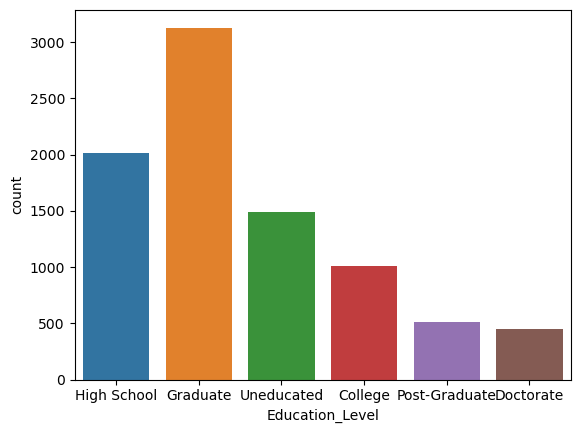

In [21]:
import matplotlib.pyplot as plt 
import seaborn as sns

sns.countplot(x = bank_dat['Education_Level'])

There is a nice gamma-like distribution in the education level of the users, with the highest likelihood being Graduates. To assess how to substitute the null values, it is worth exploring if there are any patterns between the null entries and their counterparts.

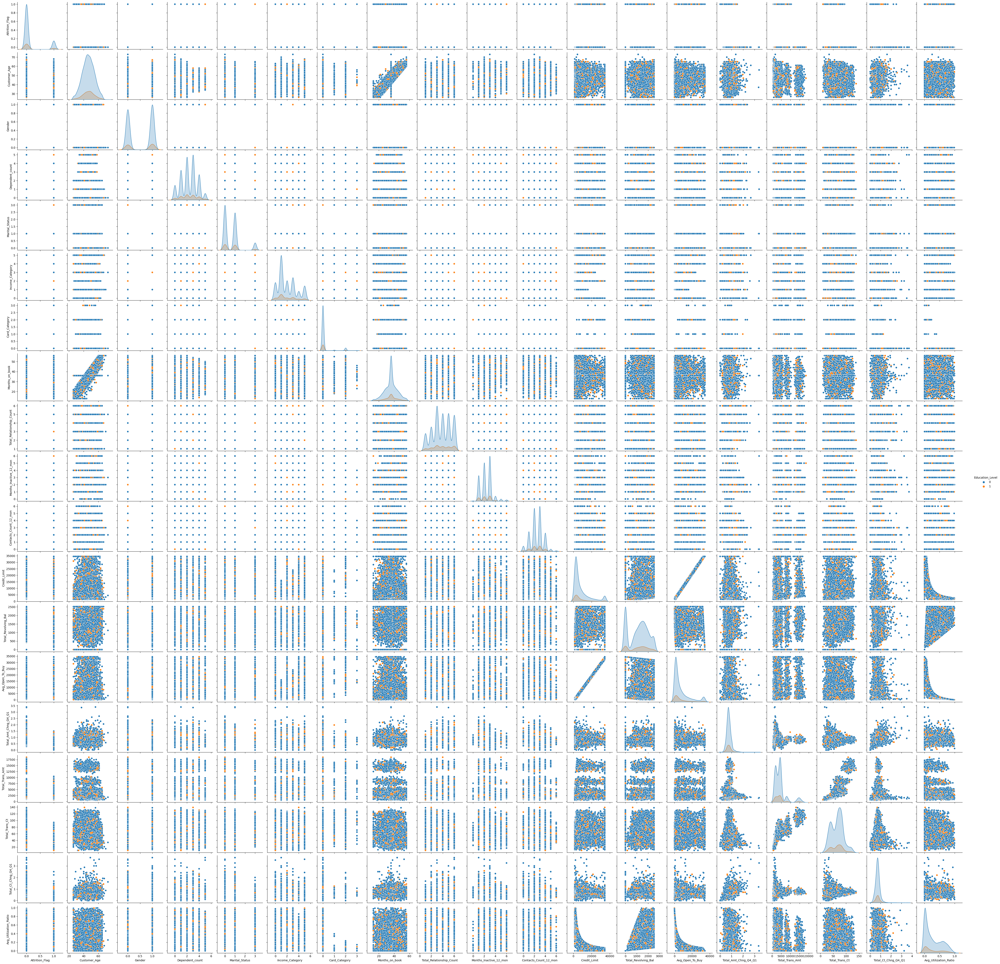

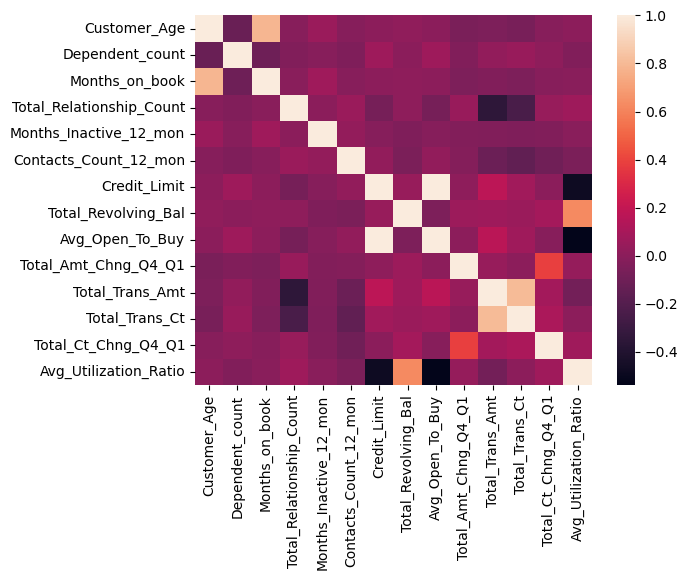

In [22]:
ed_level_df = bank_dat.copy()
ed_level_df['Education_Level'] = np.where(ed_level_df['Education_Level'].isnull(), 1 , 0)

for col in bank_dat.columns:
    if is_object_dtype(ed_level_df[col]):
        vals = pd.unique(ed_level_df[col])
        for ind,v in enumerate(vals):
            ed_level_df.loc[ed_level_df[col] == v, col] = ind

sns.pairplot(ed_level_df,hue='Education_Level')
plt.show()

sns.heatmap(bank_dat.corr())
plt.show()


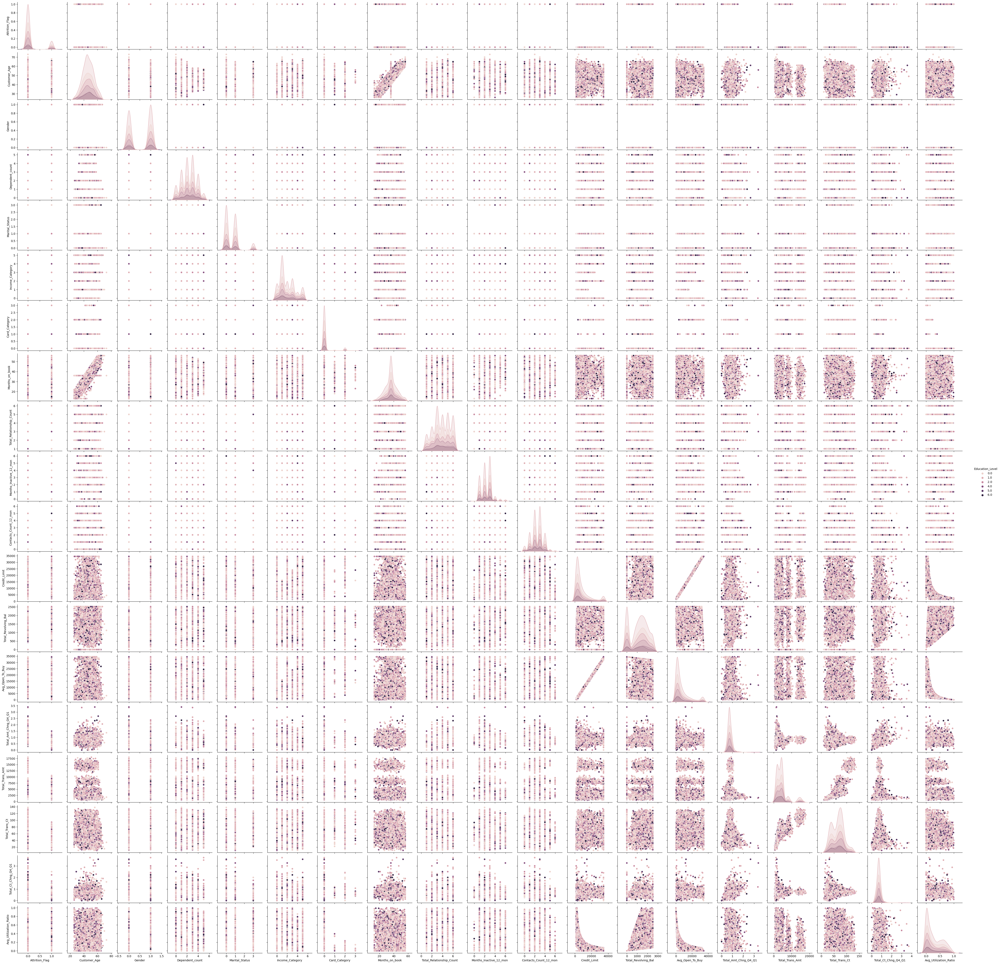

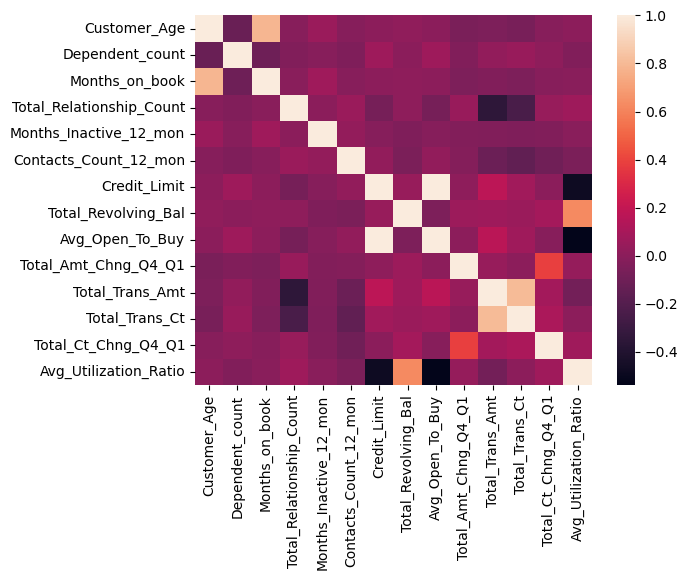

In [23]:
ed_level_df = bank_dat.copy()

for col in bank_dat.columns:
    if is_object_dtype(ed_level_df[col]):
        vals = pd.unique(ed_level_df[col])
        for ind,v in enumerate(vals):
            ed_level_df.loc[ed_level_df[col] == v, col] = ind

sns.pairplot(ed_level_df,hue='Education_Level')
plt.show()

sns.heatmap(bank_dat.corr())
plt.show()

<AxesSubplot: >

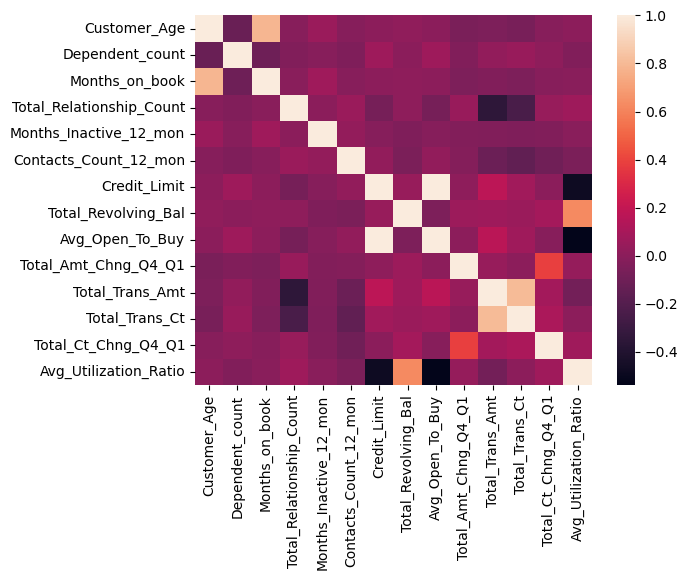

Observing the pairplot above, it is clear that the missing values of Education Level would match a random sampling of each of the numerical variables, which means there is very little to no correlation between the other properties and whether or not the value was null.

In [11]:
print(bank_dat.isnull().sum().sort_values(ascending=False)/(len(bank_dat)/100))


Education_Level             14.999506
Marital_Status               7.396070
Attrition_Flag               0.000000
Contacts_Count_12_mon        0.000000
Total_Ct_Chng_Q4_Q1          0.000000
Total_Trans_Ct               0.000000
Total_Trans_Amt              0.000000
Total_Amt_Chng_Q4_Q1         0.000000
Avg_Open_To_Buy              0.000000
Total_Revolving_Bal          0.000000
Credit_Limit                 0.000000
Months_Inactive_12_mon       0.000000
Customer_Age                 0.000000
Total_Relationship_Count     0.000000
Months_on_book               0.000000
Card_Category                0.000000
Income_Category              0.000000
Dependent_count              0.000000
Gender                       0.000000
Avg_Utilization_Ratio        0.000000
dtype: float64


,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
6,Existing Customer,51,M,4,NaN,Married,$120K +,Gold,46,6,1,3,34516.0,2264,32252.0,1.975,1330,31,0.722,0.066
11,Existing Customer,65,M,1,NaN,Married,$40K - $60K,Blue,54,6,2,3,9095.0,1587,7508.0,1.433,1314,26,1.364,0.174
15,Existing Customer,44,M,4,NaN,NaN,$80K - $120K,Blue,37,5,1,2,4234.0,972,3262.0,1.707,1348,27,1.700,0.230
17,Existing Customer,41,M,3,NaN,Married,$80K - $120K,Blue,34,4,4,1,13535.0,1291,12244.0,0.653,1028,21,1.625,0.095
23,Existing Customer,47,F,4,NaN,Single,Less than $40K,Blue,36,3,3,2,2492.0,1560,932.0,0.573,1126,23,0.353,0.626
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10090,Existing Customer,36,F,3,NaN,Married,$40K - $60K,Blue,22,5,3,3,12958.0,2273,10685.0,0.608,15681,96,0.627,0.175
10094,Existing Customer,59,M,1,NaN,Single,$60K - $80K,Blue,48,3,1,2,7288.0,0,7288.0,0.640,14873,120,0.714,0.000
10095,Existing Customer,46,M,3,NaN,Married,$80K - $120K,Blue,33,4,1,3,34516.0,1099,33417.0,0.816,15490,110,0.618,0.032
10118,Attrited Customer,50,M,1,NaN,NaN,$80K - $120K,Blue,36,6,3,4,9959.0,952,9007.0,0.825,10310,63,1.100,0.096
